# Investigating NYPD Arrest Data in the Big Apple

In [1]:
# importing pandas for data manipulation and analysis
# importing efficient numerical computing capabilities
import pandas as pd
import numpy as np

In [2]:
%cd /Users/vishesh/Downloads

/Users/vishesh/Downloads


In [3]:
# importing ignoring warnings to ignore all unexpected behavior warnings.
import warnings
warnings.filterwarnings('ignore')

## Data Collection

In [4]:
# importing NYPD Arrest_df dataset
arrest_df = pd.read_csv('NYPD_Arrest_Data__Year_to_Date_.csv')
arrest_df

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,239553009,01/23/2022,464.0,JOSTLING,230.0,JOSTLING,PL 1652501,M,Q,110,1,25-44,M,BLACK,1027679,214505,40.755336,-73.843245,POINT (-73.84324519 40.75533648)
1,239922214,01/31/2022,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601502,F,K,69,0,25-44,M,BLACK,1010576,175628,40.648698,-73.905128,POINT (-73.905128 40.648698)
2,239939130,02/01/2022,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,K,61,0,65+,M,WHITE,995118,155708,40.594054,-73.960866,POINT (-73.960866 40.594054)
3,240521791,02/13/2022,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,28,0,45-64,M,BLACK,997124,233883,40.808623,-73.953492,POINT (-73.953492 40.808623)
4,241022365,02/21/2022,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1600500,F,K,76,0,45-64,M,BLACK,986331,190452,40.689425,-73.992493,POINT (-73.992493 40.689425)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189769,261130673,12/30/2022,779.0,"PUBLIC ADMINISTRATION,UNCLASSI",126.0,MISCELLANEOUS PENAL LAW,PL 215510B,F,Q,104,0,18-24,M,WHITE HISPANIC,1013631,194630,40.700844,-73.894037,POINT (-73.894037 40.700844)
189770,261170467,12/31/2022,244.0,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,BURGLARY,PL 1402000,F,K,67,0,25-44,M,BLACK,997897,175676,40.648859,-73.950820,POINT (-73.95082 40.648859)
189771,261171884,12/31/2022,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,32,0,25-44,F,BLACK,1001767,238881,40.822332,-73.936708,POINT (-73.936708 40.822332)
189772,261176549,12/31/2022,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,Q,104,0,45-64,M,WHITE,1013705,203137,40.724193,-73.893732,POINT (-73.893732 40.724193)


In [5]:
arrest_df.tail()

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
189769,261130673,12/30/2022,779.0,"PUBLIC ADMINISTRATION,UNCLASSI",126.0,MISCELLANEOUS PENAL LAW,PL 215510B,F,Q,104,0,18-24,M,WHITE HISPANIC,1013631,194630,40.700844,-73.894037,POINT (-73.894037 40.700844)
189770,261170467,12/31/2022,244.0,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,BURGLARY,PL 1402000,F,K,67,0,25-44,M,BLACK,997897,175676,40.648859,-73.950820,POINT (-73.95082 40.648859)
189771,261171884,12/31/2022,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,32,0,25-44,F,BLACK,1001767,238881,40.822332,-73.936708,POINT (-73.936708 40.822332)
189772,261176549,12/31/2022,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,Q,104,0,45-64,M,WHITE,1013705,203137,40.724193,-73.893732,POINT (-73.893732 40.724193)
189773,261140558,12/30/2022,339.0,"LARCENY,PETIT FROM OPEN AREAS,",341.0,PETIT LARCENY,PL 1552500,M,M,24,0,65+,M,WHITE,992263,229152,40.795642,-73.971057,POINT (-73.971057 40.795642)


In [6]:
# checking the size of the dataframe
arrest_df.shape

(189774, 19)

In [7]:
arrest_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 189774 entries, 0 to 189773
Data columns (total 19 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ARREST_KEY                189774 non-null  int64  
 1   ARREST_DATE               189774 non-null  object 
 2   PD_CD                     189213 non-null  float64
 3   PD_DESC                   189774 non-null  object 
 4   KY_CD                     189204 non-null  float64
 5   OFNS_DESC                 189774 non-null  object 
 6   LAW_CODE                  189774 non-null  object 
 7   LAW_CAT_CD                188027 non-null  object 
 8   ARREST_BORO               189774 non-null  object 
 9   ARREST_PRECINCT           189774 non-null  int64  
 10  JURISDICTION_CODE         189774 non-null  int64  
 11  AGE_GROUP                 189774 non-null  object 
 12  PERP_SEX                  189774 non-null  object 
 13  PERP_RACE                 189774 non-null  o

In [8]:
# Checking the missing values in dataframe
arrest_df.isna().sum()

ARREST_KEY                     0
ARREST_DATE                    0
PD_CD                        561
PD_DESC                        0
KY_CD                        570
OFNS_DESC                      0
LAW_CODE                       0
LAW_CAT_CD                  1747
ARREST_BORO                    0
ARREST_PRECINCT                0
JURISDICTION_CODE              0
AGE_GROUP                      0
PERP_SEX                       0
PERP_RACE                      0
X_COORD_CD                     0
Y_COORD_CD                     0
Latitude                       0
Longitude                      0
New Georeferenced Column       0
dtype: int64

In [9]:
## Dropping the rows which has missing values

def drop_rows(df):
    col_drop = []
    for col in df.columns:
        missing_values = df[col].isna().sum()
        if missing_values > 1 and missing_values <= 1800:
            col_drop.append(col)
    if col_drop:
        df = df.dropna(subset=col_drop)
    return df

In [10]:
arrest_df = drop_rows(arrest_df)

In [11]:
# Checking the missing values in dataframe
arrest_df.isna().sum()

ARREST_KEY                  0
ARREST_DATE                 0
PD_CD                       0
PD_DESC                     0
KY_CD                       0
OFNS_DESC                   0
LAW_CODE                    0
LAW_CAT_CD                  0
ARREST_BORO                 0
ARREST_PRECINCT             0
JURISDICTION_CODE           0
AGE_GROUP                   0
PERP_SEX                    0
PERP_RACE                   0
X_COORD_CD                  0
Y_COORD_CD                  0
Latitude                    0
Longitude                   0
New Georeferenced Column    0
dtype: int64

In [12]:
# Checking the data types in dataframe
arrest_df.dtypes

ARREST_KEY                    int64
ARREST_DATE                  object
PD_CD                       float64
PD_DESC                      object
KY_CD                       float64
OFNS_DESC                    object
LAW_CODE                     object
LAW_CAT_CD                   object
ARREST_BORO                  object
ARREST_PRECINCT               int64
JURISDICTION_CODE             int64
AGE_GROUP                    object
PERP_SEX                     object
PERP_RACE                    object
X_COORD_CD                    int64
Y_COORD_CD                    int64
Latitude                    float64
Longitude                   float64
New Georeferenced Column     object
dtype: object

In [13]:
arrest_df

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,239553009,01/23/2022,464.0,JOSTLING,230.0,JOSTLING,PL 1652501,M,Q,110,1,25-44,M,BLACK,1027679,214505,40.755336,-73.843245,POINT (-73.84324519 40.75533648)
1,239922214,01/31/2022,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601502,F,K,69,0,25-44,M,BLACK,1010576,175628,40.648698,-73.905128,POINT (-73.905128 40.648698)
2,239939130,02/01/2022,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,K,61,0,65+,M,WHITE,995118,155708,40.594054,-73.960866,POINT (-73.960866 40.594054)
3,240521791,02/13/2022,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,28,0,45-64,M,BLACK,997124,233883,40.808623,-73.953492,POINT (-73.953492 40.808623)
4,241022365,02/21/2022,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1600500,F,K,76,0,45-64,M,BLACK,986331,190452,40.689425,-73.992493,POINT (-73.992493 40.689425)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189769,261130673,12/30/2022,779.0,"PUBLIC ADMINISTRATION,UNCLASSI",126.0,MISCELLANEOUS PENAL LAW,PL 215510B,F,Q,104,0,18-24,M,WHITE HISPANIC,1013631,194630,40.700844,-73.894037,POINT (-73.894037 40.700844)
189770,261170467,12/31/2022,244.0,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,BURGLARY,PL 1402000,F,K,67,0,25-44,M,BLACK,997897,175676,40.648859,-73.950820,POINT (-73.95082 40.648859)
189771,261171884,12/31/2022,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,32,0,25-44,F,BLACK,1001767,238881,40.822332,-73.936708,POINT (-73.936708 40.822332)
189772,261176549,12/31/2022,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,Q,104,0,45-64,M,WHITE,1013705,203137,40.724193,-73.893732,POINT (-73.893732 40.724193)


<AxesSubplot:xlabel='Latitude', ylabel='Longitude'>

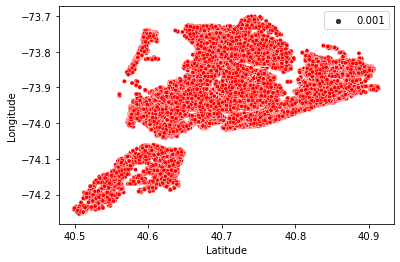

In [14]:
import seaborn as sns
sns.scatterplot(x=arrest_df.Latitude, y=arrest_df.Longitude, size=0.001, color='Red')

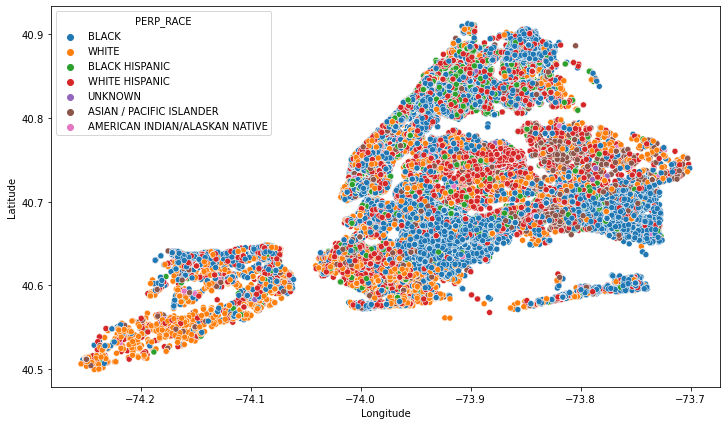

In [15]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12,7))
sns.scatterplot(arrest_df['Longitude'],arrest_df['Latitude'], marker = 'o', 
                hue = arrest_df['PERP_RACE'])
plt.show()

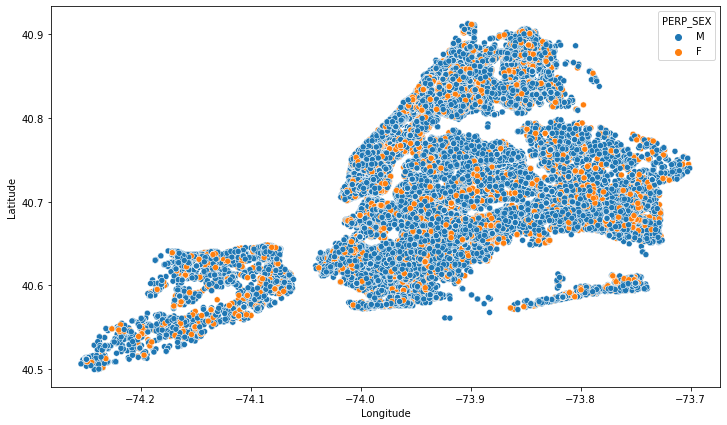

In [16]:
import matplotlib.pyplot as plt
plt.figure(figsize=(12,7))
sns.scatterplot(arrest_df['Longitude'],arrest_df['Latitude'], marker = 'o', 
                hue = arrest_df['PERP_SEX'])
plt.show()

In [17]:
arrest_df['OFNS_DESC'].unique()

array(['JOSTLING', 'ROBBERY', 'FELONY ASSAULT',
       'ASSAULT 3 & RELATED OFFENSES', 'OFFENSES INVOLVING FRAUD', 'RAPE',
       'DANGEROUS WEAPONS', 'SEX CRIMES', 'BURGLARY', 'PETIT LARCENY',
       'FRAUDS', 'FORGERY', 'ARSON', 'DANGEROUS DRUGS', 'ESCAPE 3',
       'CRIMINAL TRESPASS', 'MISCELLANEOUS PENAL LAW',
       'CRIMINAL MISCHIEF & RELATED OF', 'GRAND LARCENY',
       'GRAND LARCENY OF MOTOR VEHICLE', 'OFFENSES AGAINST PUBLIC ADMINI',
       'POSSESSION OF STOLEN PROPERTY', 'OFF. AGNST PUB ORD SENSBLTY &',
       'INTOXICATED/IMPAIRED DRIVING', "BURGLAR'S TOOLS",
       'VEHICLE AND TRAFFIC LAWS', 'INTOXICATED & IMPAIRED DRIVING',
       'UNAUTHORIZED USE OF A VEHICLE', 'THEFT-FRAUD',
       'OTHER TRAFFIC INFRACTION', 'MURDER & NON-NEGL. MANSLAUGHTE',
       'THEFT OF SERVICES', 'OTHER OFFENSES RELATED TO THEF',
       'OTHER STATE LAWS (NON PENAL LA',
       'AGRICULTURE & MRKTS LAW-UNCLASSIFIED',
       'OFFENSES AGAINST THE PERSON', 'OTHER STATE LAWS',
       'NYS LAWS-U

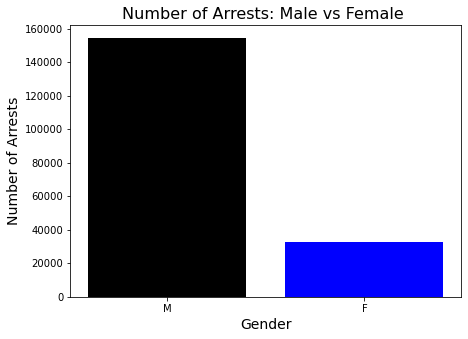

In [18]:
import matplotlib.pyplot as plt

arrest_df_grouped = arrest_df.groupby(['PERP_SEX'])['ARREST_KEY'].count()
top5 = arrest_df_grouped.nlargest(5)
plt.figure(figsize=(7,5))
plt.bar(top5.index, top5.values, color= ['black', 'blue'])
plt.xlabel('Gender', fontsize=14)
plt.ylabel('Number of Arrests', fontsize=14)
plt.title('Number of Arrests: Male vs Female ', fontsize=16)
plt.show()

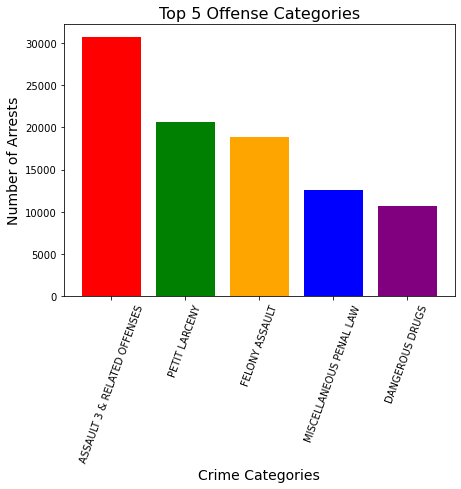

In [19]:
arrest_df_grouped = arrest_df.groupby(['OFNS_DESC'])['ARREST_KEY'].count()
top5 = arrest_df_grouped.nlargest(5)
plt.figure(figsize=(7,5))
plt.bar(top5.index, top5.values, color= ['red', 'green', 'orange', 'blue', 'purple'])
plt.xlabel('Crime Categories', fontsize=14)
plt.ylabel('Number of Arrests', fontsize=14)
plt.xticks(rotation=70)
plt.title('Top 5 Offense Categories', fontsize=16)
plt.show()

In [20]:
import plotly.express as px
def animate_map(time_col):
    fig = px.scatter_mapbox(arrest_df,
              lat="Latitude" ,
              lon="Longitude",
              hover_name=arrest_df['PERP_RACE'],
              color=arrest_df['AGE_GROUP'],
              animation_frame=time_col,
              mapbox_style='carto-positron',
              category_orders={
              time_col:list(np.sort(arrest_df[time_col].unique()))
              },                  
              zoom=10)
    fig.show();
animate_map(time_col='ARREST_DATE')

In [21]:
import plotly.express as px
fig = px.pie(arrest_df,values='ARREST_PRECINCT', names='PERP_SEX')
fig.show()

In [22]:
import plotly.express as px
fig = px.pie(arrest_df,values='ARREST_PRECINCT', names='PERP_RACE')
fig.show()

In [23]:
arrest_df.dtypes

ARREST_KEY                    int64
ARREST_DATE                  object
PD_CD                       float64
PD_DESC                      object
KY_CD                       float64
OFNS_DESC                    object
LAW_CODE                     object
LAW_CAT_CD                   object
ARREST_BORO                  object
ARREST_PRECINCT               int64
JURISDICTION_CODE             int64
AGE_GROUP                    object
PERP_SEX                     object
PERP_RACE                    object
X_COORD_CD                    int64
Y_COORD_CD                    int64
Latitude                    float64
Longitude                   float64
New Georeferenced Column     object
dtype: object

In [24]:
arrest_df['ARREST_DATE'] = pd.to_datetime(arrest_df['ARREST_DATE'])

In [25]:
arrest_df.dtypes

ARREST_KEY                           int64
ARREST_DATE                 datetime64[ns]
PD_CD                              float64
PD_DESC                             object
KY_CD                              float64
OFNS_DESC                           object
LAW_CODE                            object
LAW_CAT_CD                          object
ARREST_BORO                         object
ARREST_PRECINCT                      int64
JURISDICTION_CODE                    int64
AGE_GROUP                           object
PERP_SEX                            object
PERP_RACE                           object
X_COORD_CD                           int64
Y_COORD_CD                           int64
Latitude                           float64
Longitude                          float64
New Georeferenced Column            object
dtype: object

In [26]:
arrest_df

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,239553009,2022-01-23,464.0,JOSTLING,230.0,JOSTLING,PL 1652501,M,Q,110,1,25-44,M,BLACK,1027679,214505,40.755336,-73.843245,POINT (-73.84324519 40.75533648)
1,239922214,2022-01-31,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601502,F,K,69,0,25-44,M,BLACK,1010576,175628,40.648698,-73.905128,POINT (-73.905128 40.648698)
2,239939130,2022-02-01,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,K,61,0,65+,M,WHITE,995118,155708,40.594054,-73.960866,POINT (-73.960866 40.594054)
3,240521791,2022-02-13,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,28,0,45-64,M,BLACK,997124,233883,40.808623,-73.953492,POINT (-73.953492 40.808623)
4,241022365,2022-02-21,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1600500,F,K,76,0,45-64,M,BLACK,986331,190452,40.689425,-73.992493,POINT (-73.992493 40.689425)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189769,261130673,2022-12-30,779.0,"PUBLIC ADMINISTRATION,UNCLASSI",126.0,MISCELLANEOUS PENAL LAW,PL 215510B,F,Q,104,0,18-24,M,WHITE HISPANIC,1013631,194630,40.700844,-73.894037,POINT (-73.894037 40.700844)
189770,261170467,2022-12-31,244.0,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,BURGLARY,PL 1402000,F,K,67,0,25-44,M,BLACK,997897,175676,40.648859,-73.950820,POINT (-73.95082 40.648859)
189771,261171884,2022-12-31,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,32,0,25-44,F,BLACK,1001767,238881,40.822332,-73.936708,POINT (-73.936708 40.822332)
189772,261176549,2022-12-31,105.0,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,Q,104,0,45-64,M,WHITE,1013705,203137,40.724193,-73.893732,POINT (-73.893732 40.724193)


### Converting Categorical values into numerical values

In [27]:
# Importing LabelEncoder from Sklearn library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()
# fit the encoder to the categorical column and transform the values
arrest_df["PERP_SEX"] = le.fit_transform(arrest_df['PERP_SEX'])

In [28]:
arrest_df["PERP_SEX"]

0         1
1         1
2         1
3         1
4         1
         ..
189769    1
189770    1
189771    0
189772    1
189773    1
Name: PERP_SEX, Length: 187457, dtype: int64

In [29]:
# Importing LabelEncoder from Sklearn library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder

# create a LabelEncoder object
le = LabelEncoder()
# fit the encoder to the categorical column and transform the values
arrest_df["PERP_RACE"] = le.fit_transform(arrest_df['PERP_RACE'])

In [30]:
# Importing LabelEncoder from Sklearn library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder

# create a LabelEncoder object
le = LabelEncoder()
# fit the encoder to the categorical column and transform the values
arrest_df['LAW_CAT_CD'] = le.fit_transform(arrest_df['LAW_CAT_CD'])

In [31]:
# Importing LabelEncoder from Sklearn library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder

# create a LabelEncoder object
le = LabelEncoder()
# fit the encoder to the categorical column and transform the values
arrest_df['ARREST_BORO'] = le.fit_transform(arrest_df['ARREST_BORO'])

In [32]:
# Importing LabelEncoder from Sklearn library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder

# create a LabelEncoder object
le = LabelEncoder()
# fit the encoder to the categorical column and transform the values
arrest_df['AGE_GROUP'] = le.fit_transform(arrest_df['AGE_GROUP'])

In [33]:
# Importing LabelEncoder from Sklearn library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder

# create a LabelEncoder object
le = LabelEncoder()
# fit the encoder to the categorical column and transform the values
arrest_df['ARREST_BORO'] = le.fit_transform(arrest_df['ARREST_BORO'])

In [34]:
# Importing LabelEncoder from Sklearn library from preprocessing Module.
from sklearn.preprocessing import LabelEncoder

# create a LabelEncoder object
le = LabelEncoder()
# fit the encoder to the categorical column and transform the values
arrest_df['OFNS_DESC'] = le.fit_transform(arrest_df['OFNS_DESC'])

In [35]:
arrest_df

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
0,239553009,2022-01-23,464.0,JOSTLING,230.0,31,PL 1652501,2,3,110,1,1,1,2,1027679,214505,40.755336,-73.843245,POINT (-73.84324519 40.75533648)
1,239922214,2022-01-31,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,57,PL 1601502,0,1,69,0,1,1,2,1010576,175628,40.648698,-73.905128,POINT (-73.905128 40.648698)
2,239939130,2022-02-01,105.0,STRANGULATION 1ST,106.0,19,PL 1211200,0,1,61,0,3,1,5,995118,155708,40.594054,-73.960866,POINT (-73.960866 40.594054)
3,240521791,2022-02-13,101.0,ASSAULT 3,344.0,6,PL 1200001,2,2,28,0,2,1,2,997124,233883,40.808623,-73.953492,POINT (-73.953492 40.808623)
4,241022365,2022-02-21,397.0,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,57,PL 1600500,0,1,76,0,2,1,2,986331,190452,40.689425,-73.992493,POINT (-73.992493 40.689425)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189769,261130673,2022-12-30,779.0,"PUBLIC ADMINISTRATION,UNCLASSI",126.0,35,PL 215510B,0,3,104,0,0,1,6,1013631,194630,40.700844,-73.894037,POINT (-73.894037 40.700844)
189770,261170467,2022-12-31,244.0,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,8,PL 1402000,0,1,67,0,1,1,2,997897,175676,40.648859,-73.950820,POINT (-73.95082 40.648859)
189771,261171884,2022-12-31,101.0,ASSAULT 3,344.0,6,PL 1200001,2,2,32,0,1,0,2,1001767,238881,40.822332,-73.936708,POINT (-73.936708 40.822332)
189772,261176549,2022-12-31,105.0,STRANGULATION 1ST,106.0,19,PL 1211200,0,3,104,0,2,1,5,1013705,203137,40.724193,-73.893732,POINT (-73.893732 40.724193)


In [36]:
final_df = arrest_df[['ARREST_KEY', 'ARREST_DATE', 'PD_CD', 'KY_CD', 'LAW_CAT_CD', 'ARREST_BORO', 'ARREST_PRECINCT', 'JURISDICTION_CODE', 'AGE_GROUP', 'PERP_SEX', 'PERP_RACE', 'X_COORD_CD', 'Y_COORD_CD', 'OFNS_DESC']]
final_df

,ARREST_KEY,ARREST_DATE,PD_CD,KY_CD,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,OFNS_DESC
0,239553009,2022-01-23,464.0,230.0,2,3,110,1,1,1,2,1027679,214505,31
1,239922214,2022-01-31,397.0,105.0,0,1,69,0,1,1,2,1010576,175628,57
2,239939130,2022-02-01,105.0,106.0,0,1,61,0,3,1,5,995118,155708,19
3,240521791,2022-02-13,101.0,344.0,2,2,28,0,2,1,2,997124,233883,6
4,241022365,2022-02-21,397.0,105.0,0,1,76,0,2,1,2,986331,190452,57
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
189769,261130673,2022-12-30,779.0,126.0,0,3,104,0,0,1,6,1013631,194630,35
189770,261170467,2022-12-31,244.0,107.0,0,1,67,0,1,1,2,997897,175676,8
189771,261171884,2022-12-31,101.0,344.0,2,2,32,0,1,0,2,1001767,238881,6
189772,261176549,2022-12-31,105.0,106.0,0,3,104,0,2,1,5,1013705,203137,19


<AxesSubplot:>

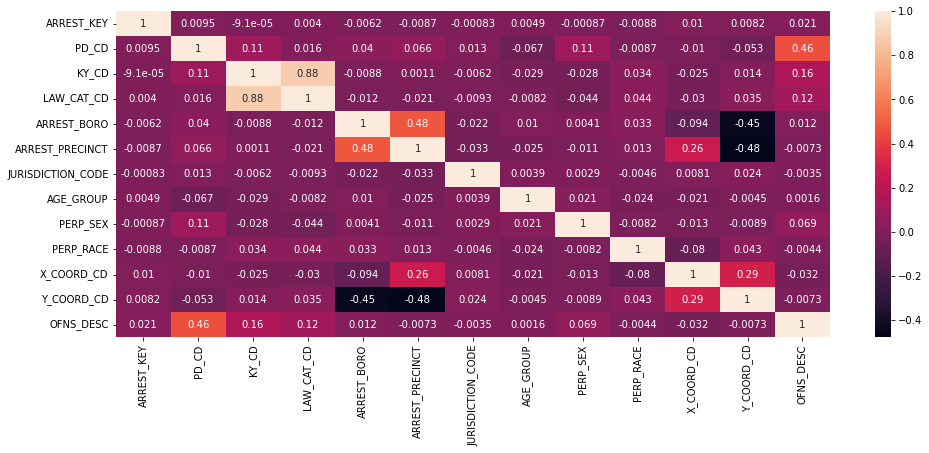

In [37]:

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(16, 6))
sns.heatmap(final_df.corr(), vmax=1, annot=True)


In [38]:
f_df = final_df[['PD_CD', 'KY_CD', 'OFNS_DESC', 'LAW_CAT_CD', 'ARREST_BORO', 'ARREST_PRECINCT', 'JURISDICTION_CODE', 'AGE_GROUP', 'PERP_SEX', 'PERP_RACE']]

In [39]:
f_df

,PD_CD,KY_CD,OFNS_DESC,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE
0,464.0,230.0,31,2,3,110,1,1,1,2
1,397.0,105.0,57,0,1,69,0,1,1,2
2,105.0,106.0,19,0,1,61,0,3,1,5
3,101.0,344.0,6,2,2,28,0,2,1,2
4,397.0,105.0,57,0,1,76,0,2,1,2
...,...,...,...,...,...,...,...,...,...,...
189769,779.0,126.0,35,0,3,104,0,0,1,6
189770,244.0,107.0,8,0,1,67,0,1,1,2
189771,101.0,344.0,6,2,2,32,0,1,0,2
189772,105.0,106.0,19,0,3,104,0,2,1,5


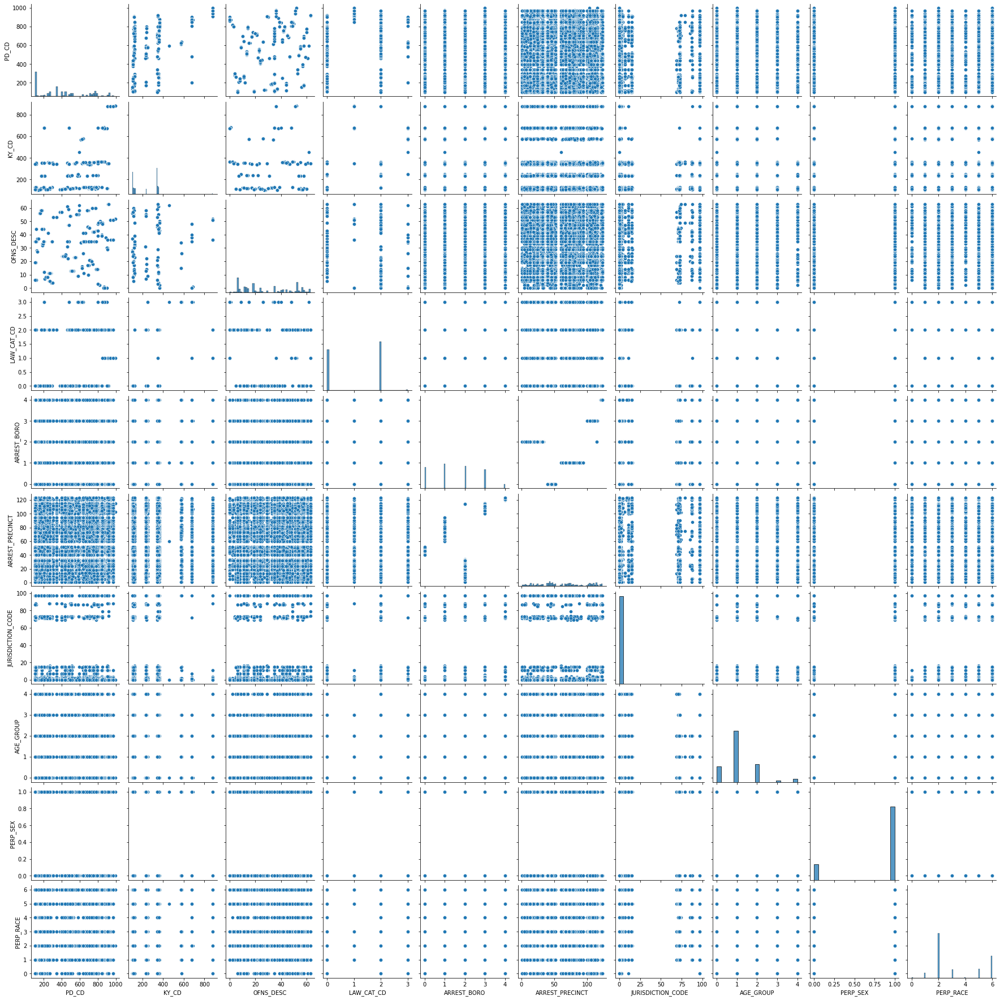

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.pairplot(f_df)

In [40]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
x_scaled = scaler.fit_transform(f_df)

Standard_data = pd.DataFrame(data = x_scaled, columns = f_df.columns)
Standard_data

,PD_CD,KY_CD,OFNS_DESC,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE
0,0.201029,-0.073157,0.096694,0.902754,1.221752,1.355167,0.007442,-0.189489,0.461766,-0.741486
1,-0.046852,-1.021458,1.434219,-1.095021,-0.473519,0.181185,-0.118536,-0.189489,0.461766,-0.741486
2,-1.127170,-1.013872,-0.520626,-1.095021,-0.473519,-0.047885,-0.118536,2.145273,0.461766,0.916724
3,-1.141969,0.791693,-1.189388,0.902754,0.374117,-0.992797,-0.118536,0.977892,0.461766,-0.741486
4,-0.046852,-1.021458,1.434219,-1.095021,-0.473519,0.381621,-0.118536,0.977892,0.461766,-0.741486
...,...,...,...,...,...,...,...,...,...,...
187452,1.366440,-0.862143,0.302467,-1.095021,1.221752,1.183365,-0.118536,-1.356871,0.461766,1.469460
187453,-0.612909,-1.006285,-1.086502,-1.095021,-0.473519,0.123918,-0.118536,-0.189489,0.461766,-0.741486
187454,-1.141969,0.791693,-1.189388,0.902754,0.374117,-0.878262,-0.118536,-0.189489,-2.165601,-0.741486
187455,-1.127170,-1.013872,-0.520626,-1.095021,1.221752,1.183365,-0.118536,0.977892,0.461766,0.916724


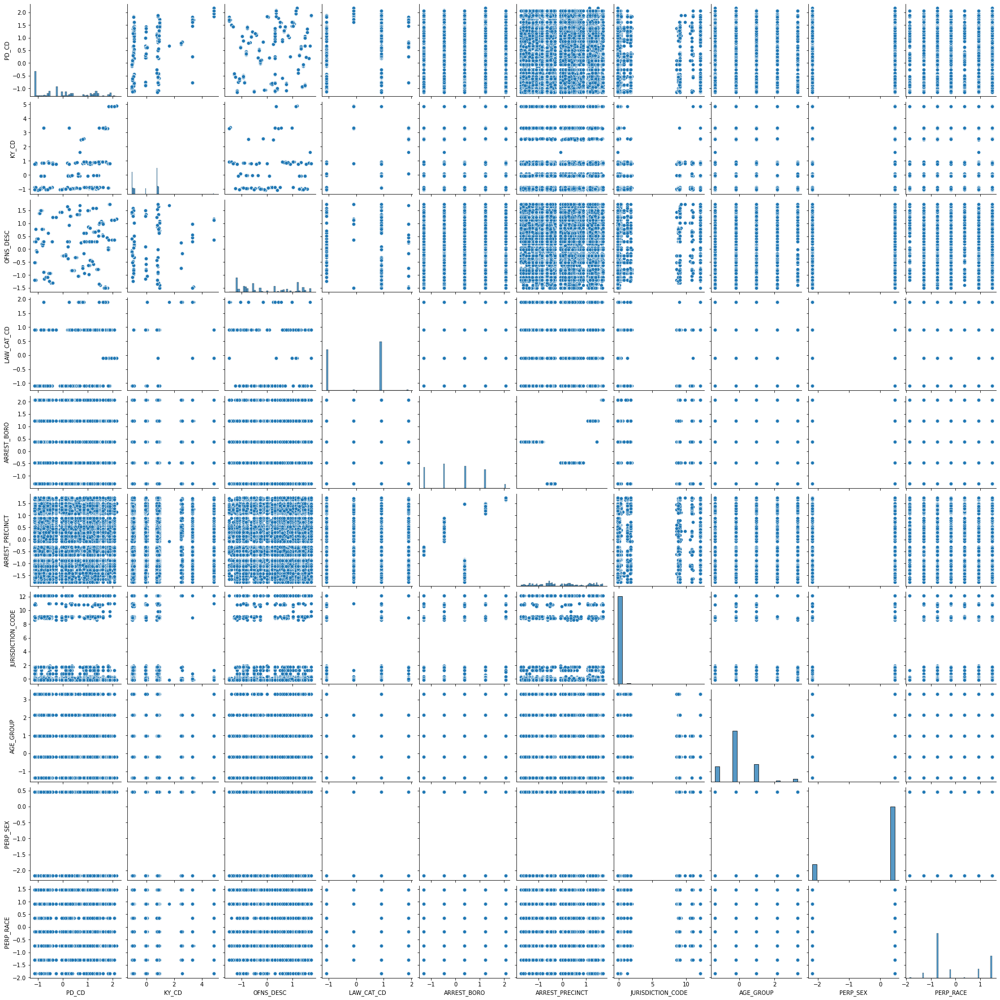

In [43]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.pairplot(Standard_data)

array([[<AxesSubplot:title={'center':'PD_CD'}>,
        <AxesSubplot:title={'center':'KY_CD'}>,
        <AxesSubplot:title={'center':'OFNS_DESC'}>],
       [<AxesSubplot:title={'center':'LAW_CAT_CD'}>,
        <AxesSubplot:title={'center':'ARREST_BORO'}>,
        <AxesSubplot:title={'center':'ARREST_PRECINCT'}>],
       [<AxesSubplot:title={'center':'JURISDICTION_CODE'}>,
        <AxesSubplot:title={'center':'AGE_GROUP'}>,
        <AxesSubplot:title={'center':'PERP_SEX'}>],
       [<AxesSubplot:title={'center':'PERP_RACE'}>, <AxesSubplot:>,
        <AxesSubplot:>]], dtype=object)

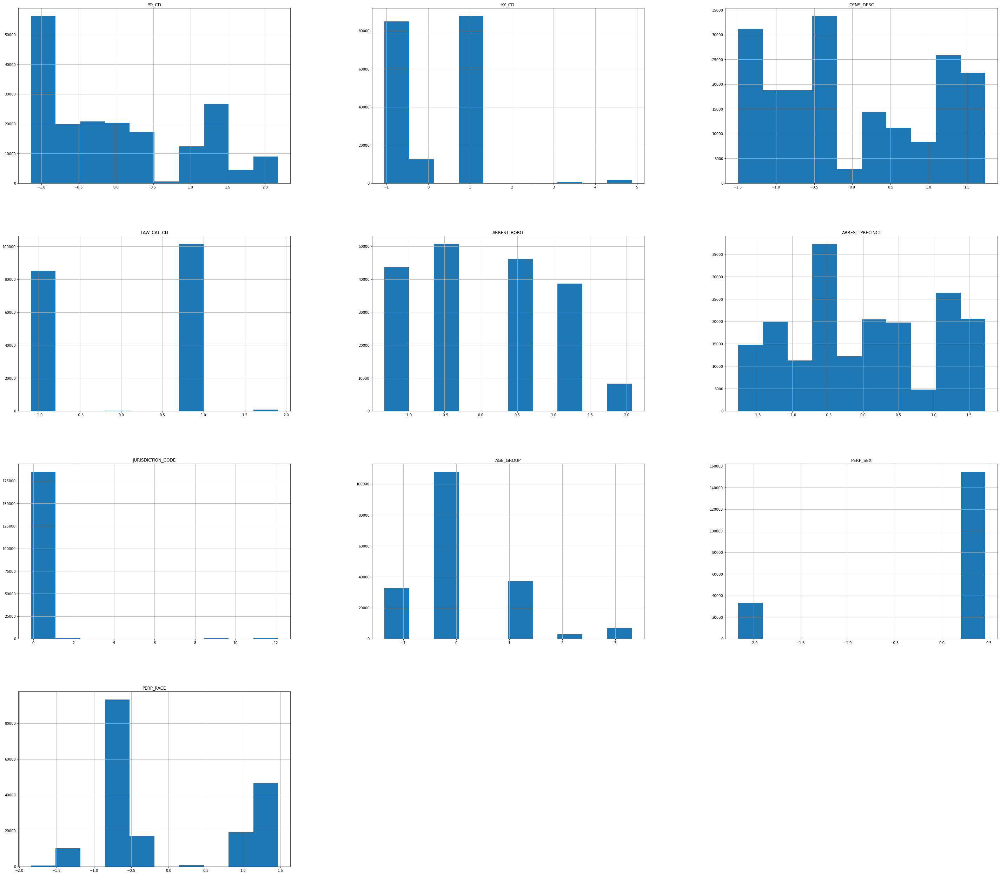

In [41]:
import matplotlib.pyplot as plt
%matplotlib inline
Standard_data.hist(figsize = (50,45))

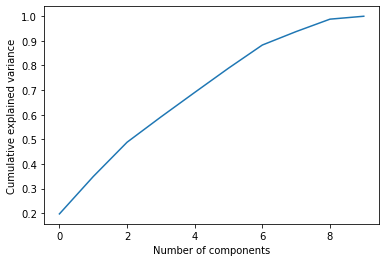

In [44]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

# create the PCA object
pca = PCA()
pca.fit(x_scaled)

# plot the scree plot
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.show()

In [47]:
from sklearn.decomposition import PCA

# create the PCA object
pca = PCA(n_components=8)

# fit the PCA object to the data
pca.fit(Standard_data)

# transform the data to the new coordinate system
data_pca = pca.transform(Standard_data)

pc_df = pd.DataFrame(data = data_pca , columns = ['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8'])
pc_df

,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8
0,0.585592,1.572965,0.735829,0.525221,0.093038,0.555707,-0.717528,-0.033936
1,-0.991494,0.539911,-1.480145,0.194972,-0.261278,0.517253,-0.064208,-0.617736
2,-1.838058,-0.613087,0.301512,1.334289,-0.194508,-1.783142,0.715980,0.095277
3,0.403540,-1.360456,1.209624,1.470290,-0.178088,-0.077521,-0.680234,-0.428396
4,-1.040237,0.601236,-1.366889,1.143803,-0.277378,0.124338,0.456226,-0.391175
...,...,...,...,...,...,...,...,...
187452,-0.731268,2.477173,-0.474046,-1.790478,0.069196,-0.811081,-0.267957,0.290123
187453,-1.868483,-0.396996,0.121495,0.219597,-0.191379,0.426755,-0.825523,0.415258
187454,0.460803,-1.549122,1.955042,-0.216159,0.001784,1.471324,0.871342,-0.439483
187455,-1.779667,1.216039,1.295608,0.568627,-0.007604,-1.323478,0.108122,-0.340314


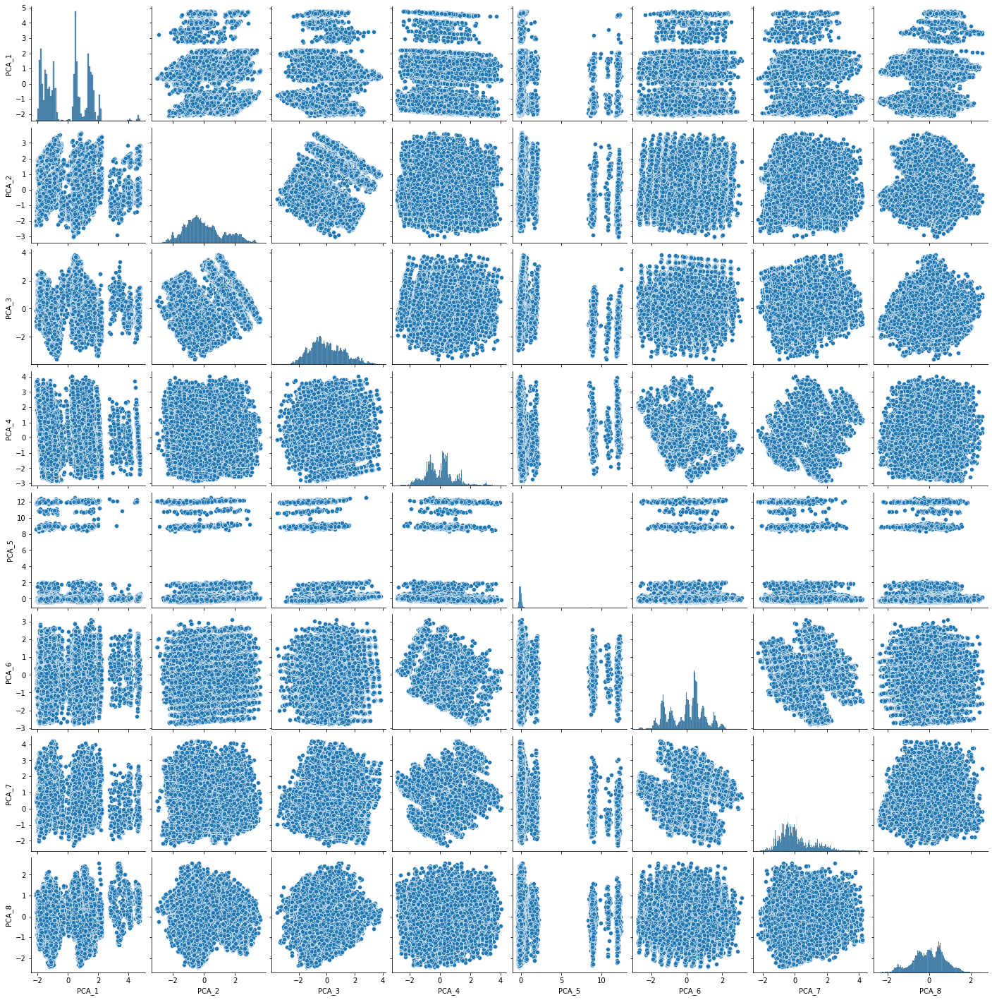

In [48]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.pairplot(pc_df)